Tutorial 3: Automated Annotation of Cell Identities in mIHC Data
================================================================

In this tutorial, we demonstrate how to use ImmunoPheno to annotate cell identities in a multiplexed IHC dataset using reference data stored in the ImmunoPhenoDB database. Specifically, we consider a human tonsil tissue section that has been profiled with PhenoCycler using a panel of 26 antibodies. For illustration purposes, we will only consider a small portion of the tissue section containing ~118k cells. The data can be found in this [link](http://).

In [1]:
!pip uninstall ImmunoPheno --y
!pip install git+https://github.com/CamaraLab/ImmunoPheno.git@package-dev --q

Found existing installation: ImmunoPheno 0.1.0
Uninstalling ImmunoPheno-0.1.0:
  Successfully uninstalled ImmunoPheno-0.1.0


In [45]:
import pandas as pd
import pickle
import plotly.express as px
import seaborn as sns
from immunopheno.data_processing import ImmunoPhenoData
from immunopheno.connect import ImmunoPhenoDB_Connect
from immunopheno.plots import plot_filter_metrics
from sklearn.metrics.pairwise import euclidean_distances

We can visualize the spatial location of the cells in the tissue:

In [2]:
spat_small = pd.read_csv("codex_small_coordinates.csv", index_col = 0)
fig = px.scatter(spat_small, x="x", y="y").update_traces(marker={'size': 1.0}).update_layout(autosize=False, height=800, width=1000).update_yaxes(scaleanchor="x",
    scaleratio=1)
fig.show()

To annotate the dataset, we first create an `ImmunoPhenoData` object containing the PhenoCycler protein expression matrix

In [3]:
ipd = ImmunoPhenoData(protein_matrix = 'codex_small_protein.csv', spreadsheet = "codex_small_spreadsheet.csv")

In addition to the protein expression matrix, we need to provide a spreadsheet containing the RRID identifiers of the monoclonal antibodies used in the experiment. This is because ImmunoPheno will use data from experiments that have used those exact antibodies or, alternatively, monoclonal antibodies from a different vendor but with the same clone ID. The file `codex_small_spreadsheet.csv` can be used as a template for your own datasets.

We first need to normalize the mIHC data using ImmunoPheno, following the procedure demonstrated in Tutorial 2. For mIHC data, a Gaussian mixture model produces optimal results for most technologies.

In [4]:
ipd.fit_all_antibodies(model="gaussian")

  0%|          | 0/26 [00:00<?, ?it/s]

Number of 3 component models: 23
Number of 2 component models: 3
Number of 1 component models: 0


In [5]:
ipd.normalize_all_antibodies(sig_expr_threshold = 0.80, bg_expr_threshold = 0.10)

  0%|          | 0/26 [00:00<?, ?it/s]

More information about good practices for normalizing protein expression values using ImmunoPheno can be found in Tutorial 2.

Once we have normalized the protein expression values, we can proceed to annotating the identity of each cell based on the information contained in the ImmunoPhenoDB database.

We first create an instance of `ImmunoPhenoDB_Connect`, which will allow us to interact with the ImmunoPhenoDB database.

In [6]:
cxn = ImmunoPhenoDB_Connect("http://ec2-100-28-86-22.compute-1.amazonaws.com")
#cxn = ImmunoPhenoDB_Connect("http://immunopheno.org")

Loading necessary files...
Connecting to database...
Connected to database.


We can see a summary of what is currently in the database using the command `db_stats()`

In [7]:
cxn.db_stats()

Database Statistics
Number of experiments: 19
Number of tissues: 3
Number of cells: 73180
Number of antibodies: 183
Number of antibody targets: 120
Number of antibody clones: 123
Average number of experiments per antibody: 4.43


We can choose to restrict the reference data to experiments using the same tissue type or to specific experiments. In this example, we will use all available data from human tonsils.

In [8]:
cxn.which_experiments("tonsil")

,idExperiment,nameExp,typeExp,pmid,doi,idBTO,tissue
0,4,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
1,5,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
2,6,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
3,7,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil
4,8,Childhood Hematopoiesis and Immune Development...,CITE,0,https://doi.org,BTO:0001387,tonsil


We observe that there are 5 experiments in the ImmunoPhenoDB database with data from human tonsils. The [BRENDA tissue ontology](https://www.ebi.ac.uk/ols4/ontologies/bto) ID of the tonsil is `BTO:001387`.

We now call `run_stvea()` to automatically annotate the identity of individual cells in the PhenoCycler data using reference data from the database. You may need to increase the number of chunks depending on the amount of memory available in your computer, as described below.

In [9]:
ipd_new = cxn.run_stvea(ipd, idBTO=["BTO:0001387"], num_chunks=4)

Retrieving reference dataset...
Number of antibodies matched from database using clone ID: 26
Imputing missing values...
Number of antibodies imputed: 3
Total number of cells returned: 10000
Number of cells imputed: 3253
Number of cell types imputed: 33
Running STvEA...
Processing chunk of size:  28599
run_cca. Time: 28.714 sec
find_nn_rna Time: 81.877 sec
find_anchor_pairs Time: 11.198 sec
filter_anchors Retained 13505 anchors! Time: 44.782 sec
score_anchors. Time: 10.638 sec
find_integration_matrix Time: 0.009 sec
find_weights Time: 57.623 sec
transform_data_matrix Time: 0.415 sec
Processing chunk of size:  28599
run_cca. Time: 31.196 sec
find_nn_rna Time: 78.777 sec
find_anchor_pairs Time: 9.617 sec
filter_anchors Retained 14006 anchors! Time: 43.478 sec
score_anchors. Time: 11.647 sec
find_integration_matrix Time: 0.007 sec
find_weights Time: 59.928 sec
transform_data_matrix Time: 0.467 sec
Processing chunk of size:  28598
run_cca. Time: 29.03 sec
find_nn_rna Time: 82.114 sec
find_

We have mostly used the default parameters of `run_stvea()`. This function is memory-intensive, and to execute it on a standard desktop, the data needs to be partitioned into chunks. Having chunks of approximately 10,000-30,000 cells is usually a good approach. Here, we have divided the dataset into `num_chunks=4` chunks. We have also restricted the reference data to human tonsils using the argument `idBTO=["BTO:0001387"]`. In general, using data from the same tissue type will lead to more accurate annotations, unless there is very limited data from that tissue in the database.

Another option of `run_stvea()` that is frequently used is `parse_option`. Here, we have used the default `parse_option=1`, which uses reference data from monoclonal antibodies from the same clone but potentially different vendors or with different modifications, such as different conjugated oligos or fluorophores, as those in the query mIHC dataset. Setting `parse_option=2` is less constraining, requiring only that the antibody protein targets match between the reference and the mIHC data. On the other hand, `parse_option=3` is more stringent, requiring the same exact antibodies (including vendor, etc.) between the reference and mIHC data. We find that `parse_option=1` generally offers the best results, except in situations where there is little overlap between the clones used in the mIHC experiment and those present in the database.

`run_stvea()` also offers the possibility of parallelization for shorter runtime, where the number of cores is specified by the argument `num_cores`. However, this increases the memory requirements. Finally, `run_stvea()` includes numerous arguments related to the mapping algorithm that may need to be adjusted for optimal results depending on the specific dataset and available computing resources. These are described in detail in the documentation of ImmunoPheno and in the original [STvEA paper](https://doi.org/10.1126/sciadv.abc5464). Increasing the value of "k" parameters, particularly `k_transfer_matrix` and `k_find_anchor`, will often increase the number of anchors and the accuracy of the annotations at the expense of a substantially larger runtime and memory requirements. Generally, for chunks of 10,000-30,000 cells, it is desirable to obtain at least ~10,000 anchors. For large datasets, we recommend experimenting with different parameter options, monitoring memory usage, on a subset of the data before running `run_stvea()` on the entire dataset.

The cell annotations are stored in the field `labels` of the ImmunoPheno object

In [10]:
print(ipd_new.labels["celltype"].value_counts().to_string())

naive B cell                                                 45128
central memory CD4-positive, alpha-beta T cell               18138
T follicular helper cell                                      6401
naive thymus-derived CD4-positive, alpha-beta T cell          5800
memory B cell                                                 5190
blood vessel endothelial cell                                 4761
centroblast                                                   4631
CD8-positive, alpha-beta T cell                               4437
plasmacytoid dendritic cell                                   2987
bronchial smooth muscle cell                                  2895
CD4-positive, CD25-positive, alpha-beta regulatory T cell     2713
follicular dendritic cell                                     2143
epithelial cell                                               2081
mesenchymal stem cell                                         1563
conventional dendritic cell                                   

Cell assignments are based on the cell type that has the highest probability for each cell. The field `cell_type_prob` contains a table with the cell-type probabilities for each cell. From this table, we can observe that some cell subtypes are harder to distinguish than others

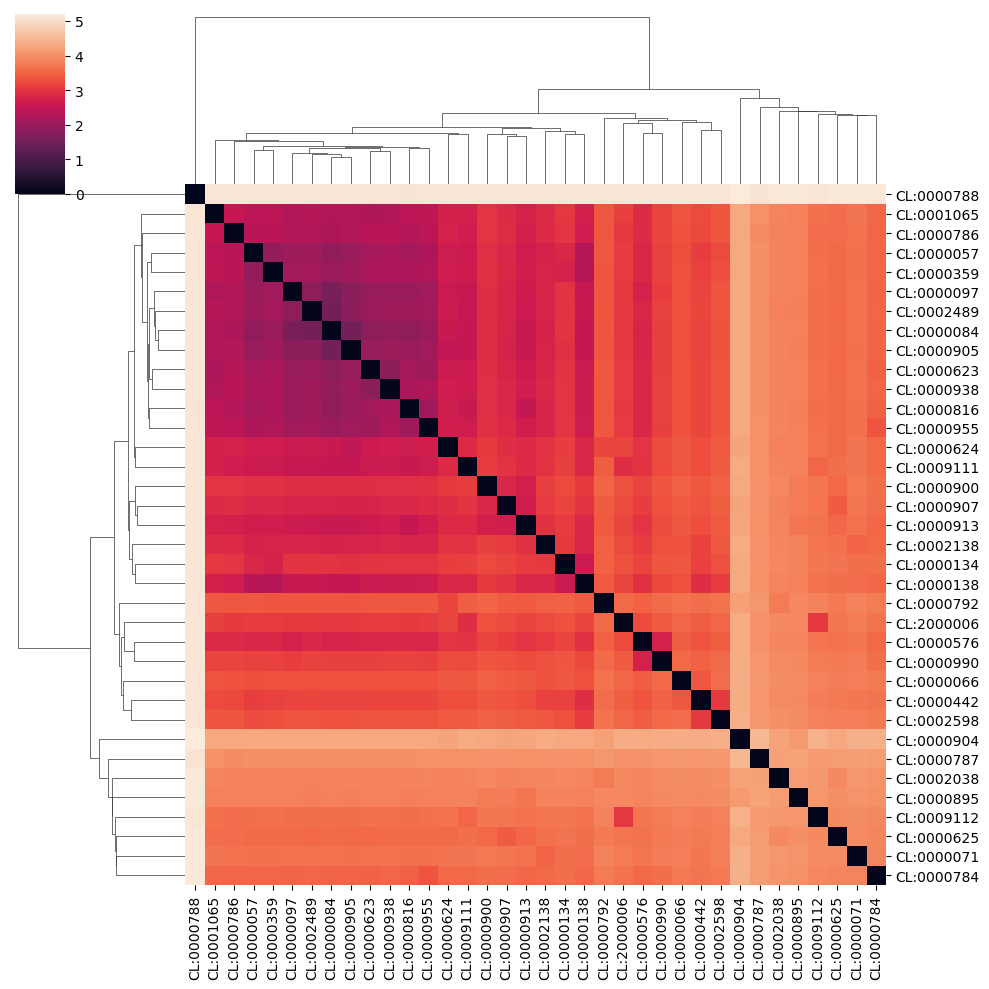

In [30]:
sns.clustermap(np.log(1+euclidean_distances(ipd_new.cell_type_prob.transpose())), xticklabels = ipd_new.cell_type_prob.transpose().index, yticklabels = ipd_new.cell_type_prob.transpose().index)

For example, we observe that distinguishing Natural Killer cells (`CL:0000623`) from CD16-negative CD56-high Natural Killer cells (`CL:0000938`) is difficult, as the former contains the latter. However, distinguishing plasmacytoid dendritic cells (`CL:0000784`) from all the other cell types is much easier. ImmunoPheno quantifies the uncertainty in the cell type assignment for each cell by computing the entropy (in base 2) of the vector of cell type probabilities for each cell. If a cell is annotated with a specific cell type with probability 1, the entropy for that cell will be zero, while cells with more uncertain assignments will have larger entropy. The maximum possible value of the entropy is log2(N), with N being the number of cell types in the dataset. The field `entropies` of the ImmunoPheno object contains the entropy of the cell assignments for each cell.

Another metric that is informative about the quality of each annotation is the ratio between D1 and D2, where D1 is the average distance in the consolidated protein space between the mIHC dataset query cell and the nearest `k_transfer_matrix` neighbors from the reference data, and D2 is the average pairwise distance in the consolidated protein space between the nearest `k_transfer_matrix` neighbors in the reference dataset, where `k_transfer_matrix` is specified in the call to `run_stvea()` (default `k_transfer_matrix=40`). A smaller value of the ratio indicates a better mapping. The field `distance_ratios` of the ImmunoPheno object contains the ratio between D1 and D2 for each cell.

The distributions of entropies and D1/D2 ratios can be visualized using `plot_filter_metrics()`

In [32]:
plot_filter_metrics(ipd_new)

As detailed above, the quality of the annotations can be increased by taking larger values of `k_transfer_matrix` and `k_find_anchor` in `run_stvea()`, and this should be reflected in these metrics.

We can filter out poor-quality annotations based on these two quantities using `filter_labels()`. In this example, we will filter out cells with D1/D2 > 22 and entropy > 3

In [33]:
ipd_new = cxn.filter_labels(ipd_new, distance_ratio = True, entropy = True, distance_ratio_threshold=22, entropy_threshold = 3)

Performing nearest neighbor distance ratio filtering...
Number of cells renamed to 'Not Assigned': 6362
epithelial cell (CL:0000066): 12
blood vessel endothelial cell (CL:0000071): 213
mesenchymal stem cell (CL:0000134): 11
follicular dendritic cell (CL:0000442): 4
monocyte (CL:0000576): 1
CD8-positive, alpha-beta T cell (CL:0000625): 464
plasmacytoid dendritic cell (CL:0000784): 101
memory B cell (CL:0000787): 167
naive B cell (CL:0000788): 2390
CD4-positive, CD25-positive, alpha-beta regulatory T cell (CL:0000792): 4
naive thymus-derived CD4-positive, alpha-beta T cell (CL:0000895): 759
naive thymus-derived CD8-positive, alpha-beta T cell (CL:0000900): 213
central memory CD4-positive, alpha-beta T cell (CL:0000904): 1477
central memory CD8-positive, alpha-beta T cell (CL:0000907): 28
effector memory CD8-positive, alpha-beta T cell (CL:0000913): 1
conventional dendritic cell (CL:0000990): 8
T follicular helper cell (CL:0002038): 136
endothelial cell of lymphatic vessel (CL:0002138): 1

In addition, ImmunoPheno can identify and filter out low-quality annotations by looking at the localization of the annotations in the mIHC protein expression space. Cells annotated in the same manner but with inconsistent protein expression profiles (and therefore randomly scattered in the protein expression space) will be removed. Additionally, different annotations that cannot be separated in the protein expression space are merged into a single annotation.

In [34]:
ipd_new = cxn.filter_labels(ipd_new, localization = True, merging = True)

Performing localization...
Downsampling dataset to 5000 cells...
Calculating pairwise distances between cells...
Generating cell graph...
Conducting fisher exact test for each cell type...
Number of cell types to rename: 4
fibroblast (CL:0000057): 1
mast cell (CL:0000097): 11
chondrocyte (CL:0000138): 6
vascular associated smooth muscle cell (CL:0000359): 1
Renaming 19 cells with 'Not Assigned' label...
Renamed 19 cells.
Localization complete.

Performing merging...
Number of cell types merged: 0
Merging complete.



Filtered out cells are labeled as `Not Assigned`

In [35]:
print(ipd_new.labels["celltype"].value_counts().to_string())

naive B cell                                                 41278
Not Assigned                                                 16356
central memory CD4-positive, alpha-beta T cell               14521
T follicular helper cell                                      5869
memory B cell                                                 4644
naive thymus-derived CD4-positive, alpha-beta T cell          4636
centroblast                                                   4341
CD8-positive, alpha-beta T cell                               3468
blood vessel endothelial cell                                 3057
plasmacytoid dendritic cell                                   2657
bronchial smooth muscle cell                                  2388
CD4-positive, CD25-positive, alpha-beta regulatory T cell     2313
epithelial cell                                               1810
follicular dendritic cell                                     1784
conventional dendritic cell                                   

The location of the annotated cells in the tissue section recapitulates the known architecture of human tonsils,

In [43]:
spat_small.loc[ipd_new.labels.index, "celltype"] = ipd_new.labels["celltype"]
fig = px.scatter(spat_small, x="x", y="y", color="celltype", color_discrete_sequence=px.colors.qualitative.Vivid_r).update_traces(marker={'size': 1.4}).update_layout(autosize=False, height=1000, width=1500).update_yaxes(scaleanchor="x",
    scaleratio=1)
fig.show()

Finally, we can serialize the annotated ImmunoPheno object into a pickle file for future use

In [44]:
## To save the ImmunoPheno object into a pickle file
with open('ipd_new_pickle', 'wb') as sample:
    pickle.dump(ipd_new, sample)

## To load the ImmunoPheno object from the pickle file:
# with open('ipd_new_pickle', 'rb') as sample:
#     ipd_new = pickle.load(sample)